# Importação de pacotes

In [161]:
import plotly.io as pio
import plotly.graph_objects as go

#pio.renderers.default='notebook'
pio.renderers.default='svg'
layout = {
  'width': 1410,
  'height': 525
}
from sklearnex import patch_sklearn
patch_sklearn()

import warnings
warnings.filterwarnings('ignore')
import logging
logging.disable(logging.INFO)

Intel(R) Extension for Scikit-learn* enabled (https://github.com/intel/scikit-learn-intelex)


In [162]:
from IPython.display import display
import pandas as pd
#import seaborn as sns
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as colors
from sklearn import linear_model, ensemble, set_config
from sklearn.metrics import mean_squared_error, mean_absolute_error, mean_absolute_percentage_error
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import OneHotEncoder, MinMaxScaler
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split
import plotly.express as px
from dataprep.eda import create_report
import xgboost as xgb
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import plotly.express as px

from sklearn.tree import plot_tree, DecisionTreeClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn import tree
import xgboost as xgb
from tensorflow import keras
from tensorflow.keras import layers
from sklearn.svm import SVC
from sklearn.naive_bayes import GaussianNB, CategoricalNB
import lightgbm as lgb
from catboost import CatBoostClassifier
from sklearn.svm import SVC
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
from sklearn.inspection import PartialDependenceDisplay
from sklearn.utils import class_weight

# selecao modelos
from sklearn.metrics import mean_squared_error as mse
from sklearn.metrics import accuracy_score as acc
from sklearn.metrics import f1_score as f1
from sklearn.metrics import brier_score_loss as brier
from sklearn.metrics import log_loss, precision_score, recall_score
from sklearn import metrics
from sklearn.metrics import make_scorer
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV
from sklearn.metrics  import RocCurveDisplay, PrecisionRecallDisplay
from category_encoders import CatBoostEncoder, CountEncoder
import lime
set_config(enable_metadata_routing=False)

# Importação de dados

In [163]:
df = pd.read_csv('iml1_unidade2_dados.csv')

# Análise Descritiva

In [164]:
display(df.info())
display(df.head(4))

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10127 entries, 0 to 10126
Data columns (total 22 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Unnamed: 0                10127 non-null  int64  
 1   CLIENTNUM                 10127 non-null  int64  
 2   Customer_Age              10127 non-null  int64  
 3   Gender                    10127 non-null  object 
 4   Dependent_count           10127 non-null  int64  
 5   Education_Level           10127 non-null  object 
 6   Marital_Status            10127 non-null  object 
 7   Income_Category           10127 non-null  object 
 8   Card_Category             10127 non-null  object 
 9   Months_on_book            10127 non-null  int64  
 10  Total_Relationship_Count  10127 non-null  int64  
 11  Months_Inactive_12_mon    10127 non-null  int64  
 12  Contacts_Count_12_mon     10127 non-null  int64  
 13  Credit_Limit              10127 non-null  float64
 14  Total_

None

,Unnamed: 0,CLIENTNUM,Customer_Age,Gender,Dependent_count,Education_Level,Marital_Status,Income_Category,Card_Category,Months_on_book,...,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio,churn
0,0,768805383,45,M,3,High School,Married,$60K - $80K,Blue,39,...,3,12691.0,777,11914.0,1.335,1144,42,1.625,0.061,0
1,1,818770008,49,F,5,Graduate,Single,Less than $40K,Blue,44,...,2,8256.0,864,7392.0,1.541,1291,33,3.714,0.105,0
2,2,713982108,51,M,3,Graduate,Married,$80K - $120K,Blue,36,...,0,3418.0,0,3418.0,2.594,1887,20,2.333,0.000,0
3,3,769911858,40,F,4,High School,Unknown,Less than $40K,Blue,34,...,1,3313.0,2517,796.0,1.405,1171,20,2.333,0.760,0


### **Descrição das variáveis:**

- Customer_Age - idade do cliente em anos
- Gender: gênero (M para Masculino, F para Feminino)
- Dependent_count: Número de dependentes
- Education_Level: qualificação educacional do titular da conta (exemplo: ensino médio, graduação, etc.)
- Marital_Status: estado civil (Casado, Solteiro, Divorciado, Desconhecido)
- Income_Category: categoria de renda anual do titular da conta (< $40K, $40K - 60K, $60K - $80K, $80K-$120K, > $120K, Desconhecido)
- Card_Category: tipo de cartão (Blue, Silver, Gold, Platinum)
- Months_on_book: período de relacionamento com o banco
- Total_Relationship_Count: número total de produtos mantidos pelo cliente
- Months_Inactive_12_mon: número de meses inativo nos últimos 12 meses
- Contacts_Count_12_mon: número de contatos nos últimos 12 meses
- Credit_Limit: limite de crédito no cartão de crédito
- Total_Revolving_Bal: saldo total rotativo no cartão de crédito
- Avg_Open_To_Buy: linha de crédito disponível para compras (Média dos últimos 12 meses)
- Total_Amt_Chng_Q4_Q1: mudança no valor das transações (Q4 sobre Q1)
- Total_Trans_Amt: valor total das transações (Últimos 12 meses)
- Total_Trans_Ct: contagem total de transações (Últimos 12 meses)
- Total_Ct_Chng_Q4_Q1: mudança na contagem de transações (Q4 sobre Q1)
- Avg_Utilization_Ratio: taxa média de utilização do cartão
- Churn: Se o cliente cancelou ou desistiu. (variável de interesse)

### Variáveis categóricas:
  - Gender
  - Education_Level	
  - Marital_Status
  - Income_Category
  - Card_Category

  0%|          | 0/3321 [00:00<?, ?it/s]

DataPrep Report
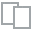
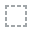
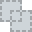
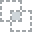
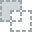
...
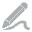
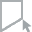
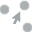
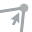
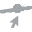

In [165]:
create_report(df)

# Análise Exploratória

### Verificar balanceamento de variáveis categóricas

In [166]:
df['Gender'].value_counts()

F    5358
M    4769
Name: Gender, dtype: int64

In [167]:
df['Education_Level'].value_counts()

Graduate         3128
High School      2013
Unknown          1519
Uneducated       1487
College          1013
Post-Graduate     516
Doctorate         451
Name: Education_Level, dtype: int64

In [168]:
df['Marital_Status'].value_counts()

Married     4687
Single      3943
Unknown      749
Divorced     748
Name: Marital_Status, dtype: int64

In [169]:
df['Income_Category'].value_counts()

Less than $40K    3561
$40K - $60K       1790
$80K - $120K      1535
$60K - $80K       1402
Unknown           1112
$120K +            727
Name: Income_Category, dtype: int64

In [170]:
df['Card_Category'].value_counts()

Blue        9436
Silver       555
Gold         116
Platinum      20
Name: Card_Category, dtype: int64

### Verificar balanceamento da variável de interesse

In [171]:
df['churn'].value_counts()

0    8500
1    1627
Name: churn, dtype: int64

### Distribuição de algumas variáveis numéricas

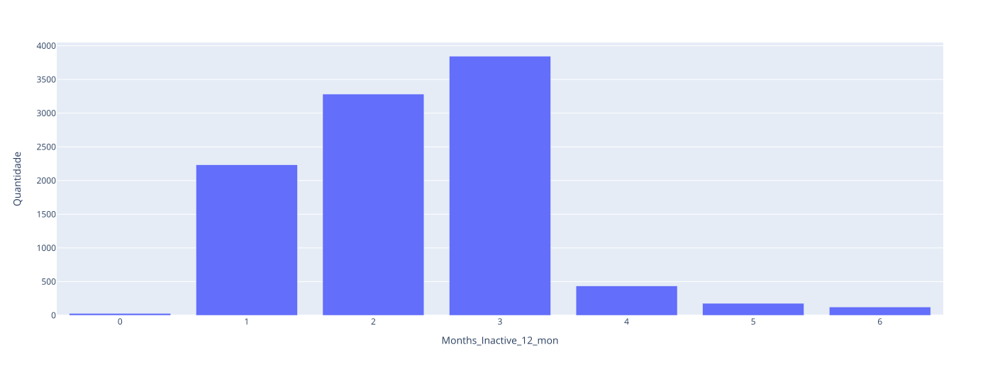

In [172]:
# Meses inativo
px.bar(df['Months_Inactive_12_mon'].value_counts().sort_index()).update_layout(
  xaxis_title="Months_Inactive_12_mon", yaxis_title="Quantidade", showlegend=False, **layout
)

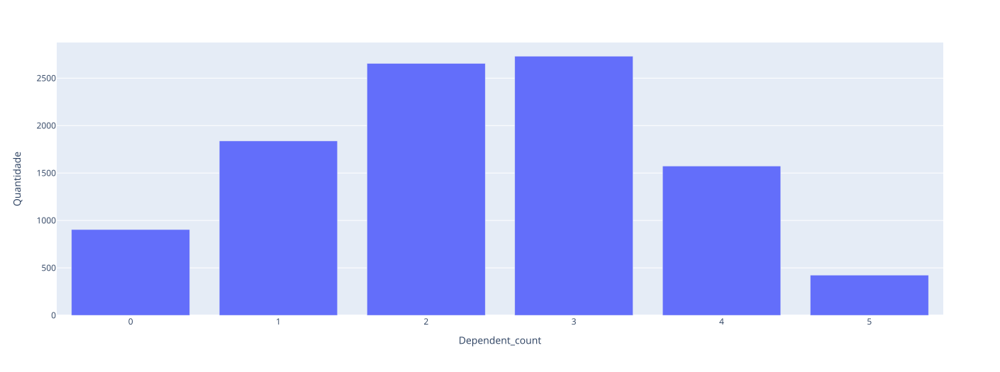

In [173]:
# Número de dependentes
px.bar(df['Dependent_count'].value_counts().sort_index()).update_layout(
  xaxis_title="Dependent_count", yaxis_title="Quantidade", showlegend=False, **layout
)

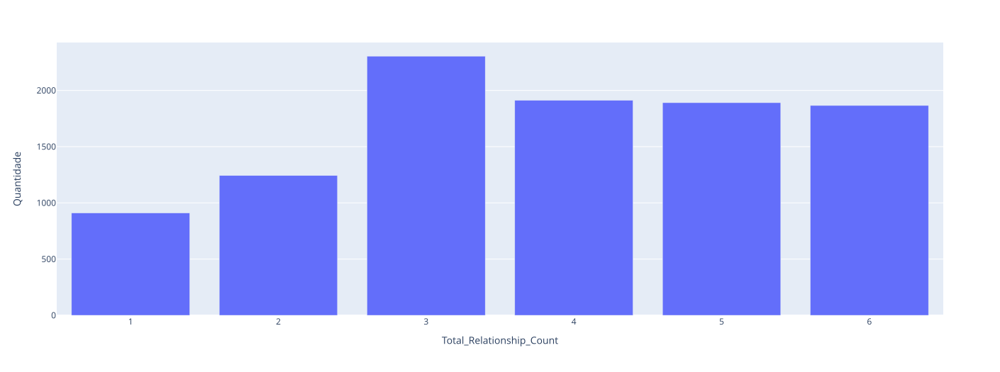

In [174]:
# Número de produtos que o cliente possui
px.bar(df['Total_Relationship_Count'].value_counts().sort_index()).update_layout(
  xaxis_title="Total_Relationship_Count", yaxis_title="Quantidade", showlegend=False, **layout
)

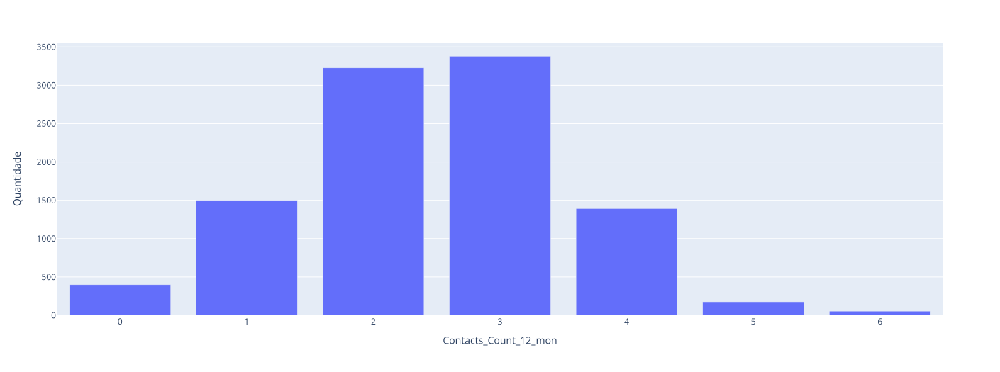

In [175]:
# Contatos nos últimos 12 meses
px.bar(df['Contacts_Count_12_mon'].value_counts().sort_index()).update_layout(
  xaxis_title="Contacts_Count_12_mon", yaxis_title="Quantidade", showlegend=False, **layout
)

### Analisando correlações positivas

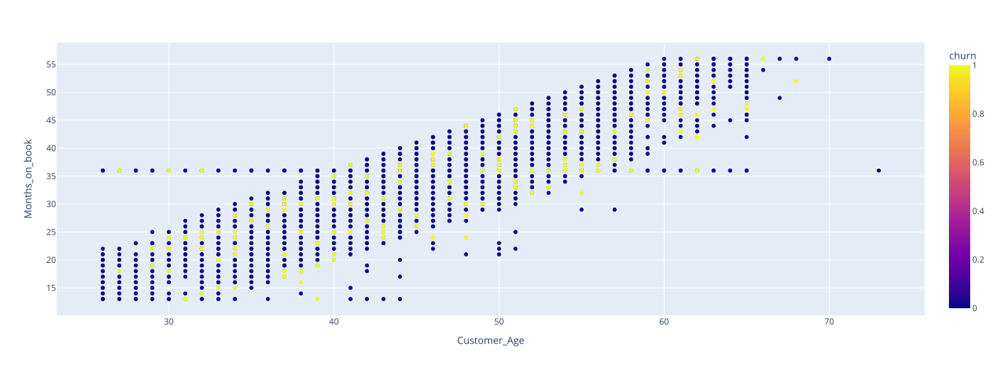

In [176]:
# Tempo de relacionamento por idade
px.scatter(df, x='Customer_Age', y='Months_on_book', color='churn', **layout)

  - Há certa correlação entre idade e tempo de relacionamento com o banco.
  - De certa forma isso é esperado, pois quanto mais idade, maior é o tempo que a pessoa é bancarizada, porém, a variável "tempo de relacionamento" está entre 1 e 5 anos, o que pode indicar que o banco é novo, ou que os dados foram selecionados de modo a não expressar corretamente a realidade.
  - A correlação não necessariamente significa que o banco faz bom trabalho em reter clientes, pois os clientes perdidos não estão nessa base (viés do sobrevivente).

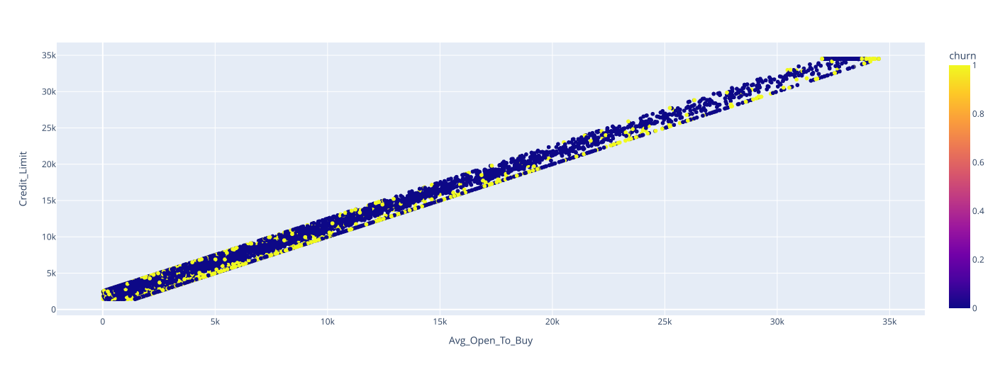

In [177]:
# Limite no cartão pelo valor disponível em linha crédito.
px.scatter(df, x='Avg_Open_To_Buy', y='Credit_Limit', color='churn', **layout)

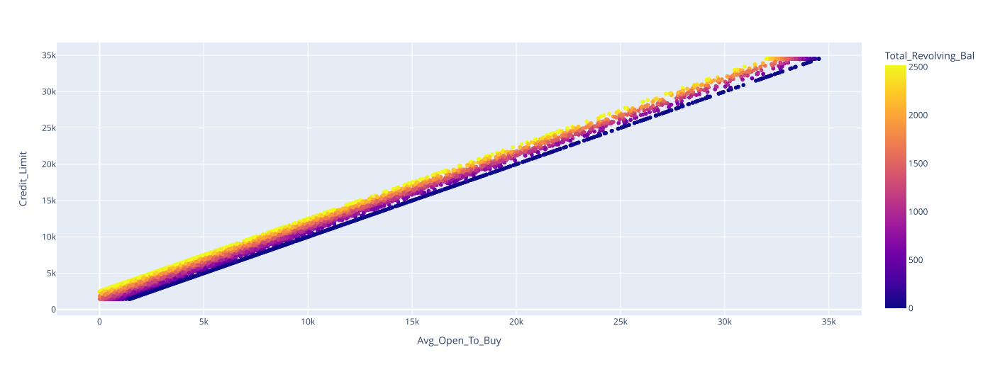

In [178]:
# Mesmo gráfico, porém analisando o saldo rotativo.
px.scatter(df, x='Avg_Open_To_Buy', y='Credit_Limit', color='Total_Revolving_Bal', **layout)

  - Quanto mais limite no cartão, mais dinheiro disponível em linha de crédito.
  - É possível perceber que o saldo rotativo desloca a reta verticalmente. 
  
  - Pela escala no saldo rotativo, pode-se inferir que Avg_Open_To_Buy + Total_Revolving_Bal == Credit_Limit, e isso pode ser provado:

In [179]:

len(df[df['Credit_Limit'] != df['Avg_Open_To_Buy'] + df['Total_Revolving_Bal']])

0

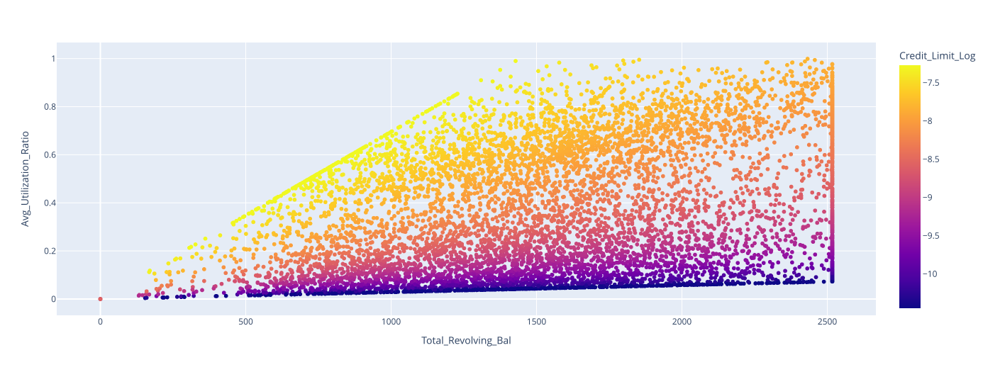

In [180]:
# Taxa média de utilização do cartão pelo saldo total rotativo (crédito rotativo é quando parte da fatura não é paga e entra no mês seguinte)
df['Credit_Limit_Log'] = np.log(1/df['Credit_Limit'])
px.scatter(df, x='Total_Revolving_Bal', y='Avg_Utilization_Ratio', color='Credit_Limit_Log', **layout)

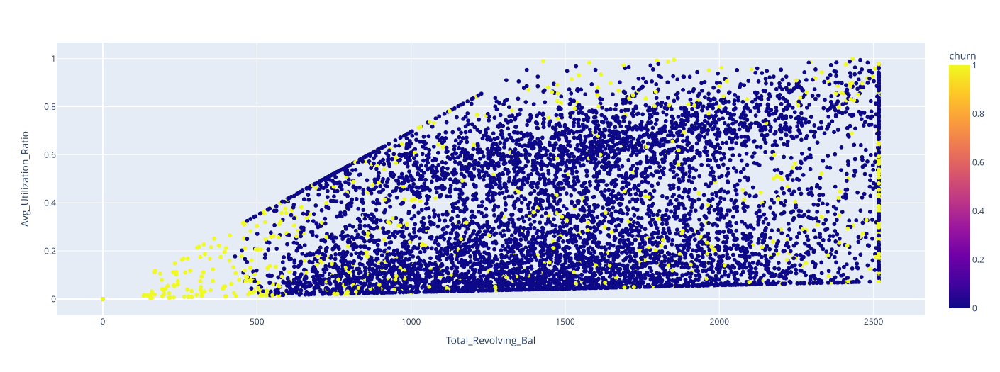

In [181]:
# Mesmo gráfico, desta vez analizando a variável de interesse (churn)
px.scatter(df, x='Total_Revolving_Bal', y='Avg_Utilization_Ratio', color='churn', **layout)

  - Em relação à desistência de compra (churn), pode-se notar uma grande concentração em região de baixa taxa de utilização e baixo saldo rotativo.
  - Há visivelmente duas linhas que se comportam como limite inferior e superior.
  - Interessante notar que as linhas parecem representar limites de cartão aproximadamente constantes, porém, desta vez, interfere na inclinação.
  - Isso indica que Avg_Utilization_Ratio ~ Total_Revolving_Bal / Credit_Limit
  - Testando, temos:

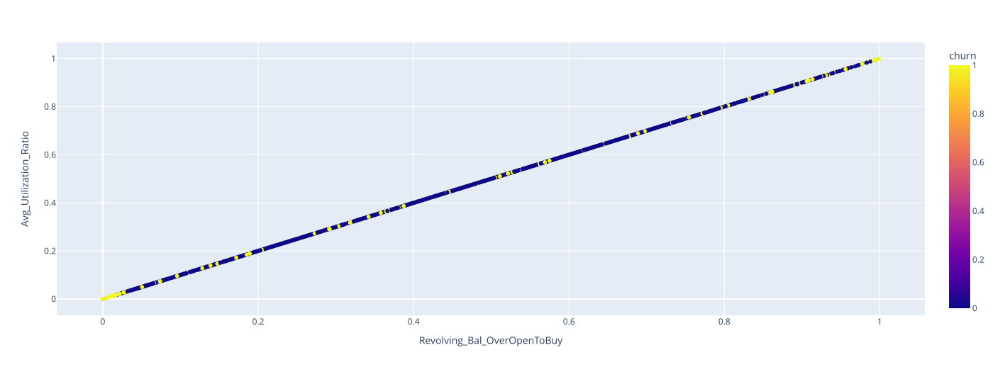

In [182]:
df['Revolving_Bal_OverOpenToBuy'] = df['Total_Revolving_Bal'] / df['Credit_Limit']
px.scatter(df, x='Revolving_Bal_OverOpenToBuy', y='Avg_Utilization_Ratio', color='churn', **layout)

In [183]:
df[np.abs((df['Total_Revolving_Bal'] / df['Credit_Limit']) - df['Avg_Utilization_Ratio']) > 0.001]

,Unnamed: 0,CLIENTNUM,Customer_Age,Gender,Dependent_count,Education_Level,Marital_Status,Income_Category,Card_Category,Months_on_book,...,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio,churn,Credit_Limit_Log,Revolving_Bal_OverOpenToBuy


  - Portanto, a taxa de utilização é calculada como sendo o saldo rotativo dividido pelo limite do cartão.

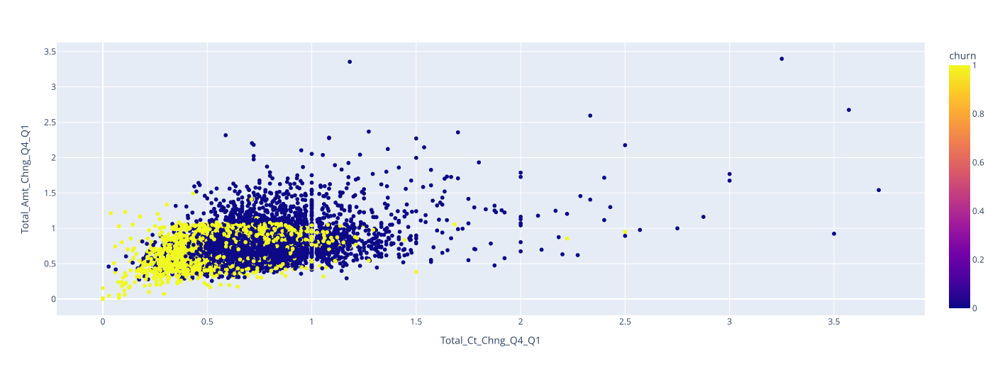

In [184]:
# Mudança no valor das transações pela mudança na contagem de transações.
# A mudança é o Q4/Q1, ou seja, valor do quarto quadrimestre pelo valor do primeiro.
px.scatter(df, x='Total_Ct_Chng_Q4_Q1', y='Total_Amt_Chng_Q4_Q1', color='churn', **layout)

  - É possível notar que as desistências se concentram em valores de quantidade e contagem menores que 1.
  - Faz sentido, pois valores menores do que 1 indicam tendência decrescente no consumo.

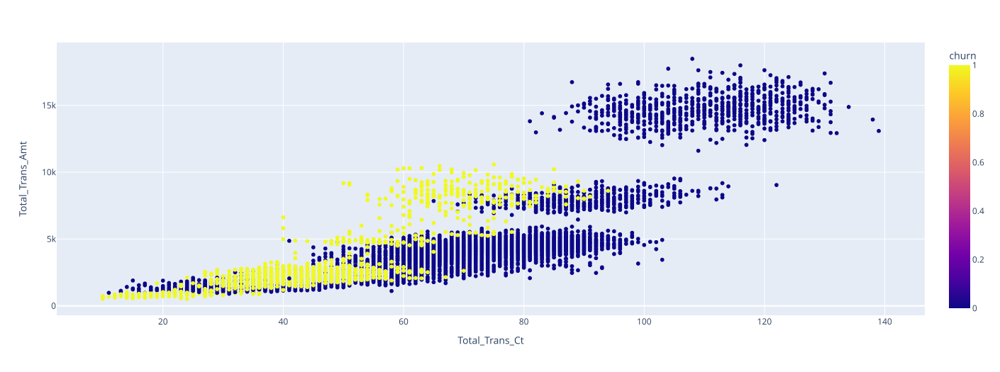

In [185]:
# Valor total das transações pela quantidade total das transações nos últimos 12 meses
px.scatter(df, x='Total_Trans_Ct', y='Total_Trans_Amt', color='churn', **layout)

  - Pode-se observar que para valores altos de transação (> 11k), não há desistência.

### Analisando correlações negativas

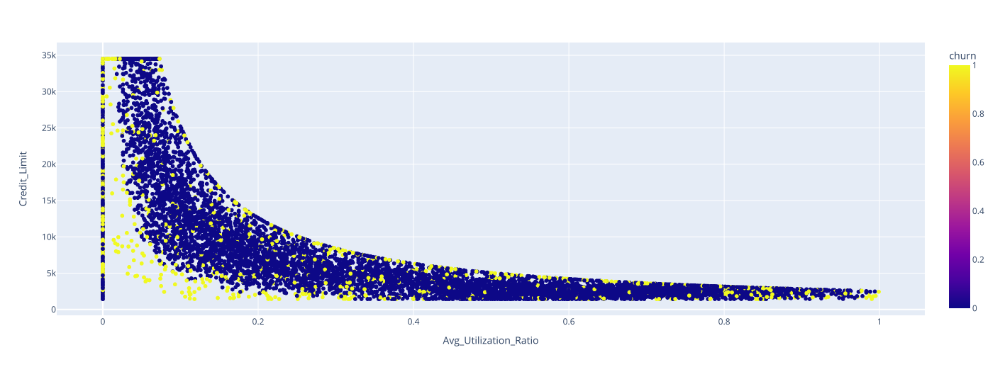

In [186]:
# Preço por quantidade de quartos
px.scatter(df, x='Avg_Utilization_Ratio', y='Credit_Limit', color='churn', **layout)

  - Quanto maior a taxa de utilização, menos limite de crédito é oferecido.

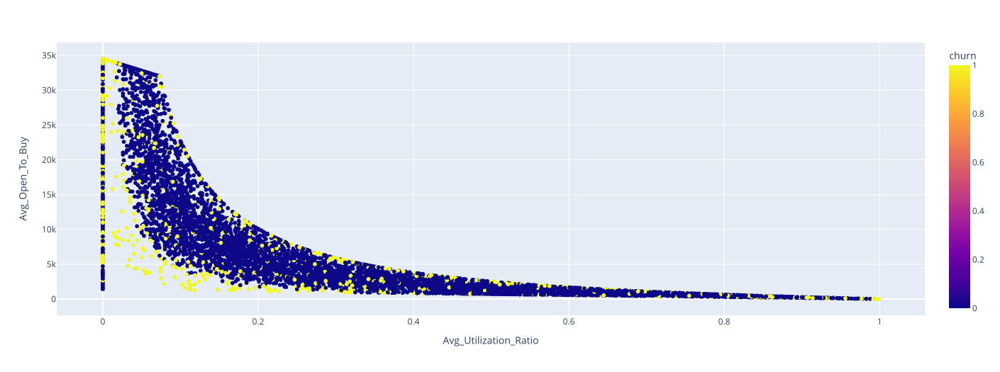

In [187]:
# Preço por quantidade de quartos
px.scatter(df, x='Avg_Utilization_Ratio', y='Avg_Open_To_Buy', color='churn', **layout)

  - Resultado foi semelhante ao gráfico anterior e isso faz sentido, já que Avg_Utilization_Ratio e Avg_Open_To_Buy tem forte correlação, conforme já foi verificado.

# Engenharia de Recursos

### Parâmetros selecionados

  - Customer_Age
  - Gender
  - Dependent_count
  - Education_Level
  - Marital_Status
  - Income_Category
  - Card_Category
  - Months_on_book
  - Total_Relationship_Count
  - Months_Inactive_12_mon
  - Contacts_Count_12_mon
  - Total_Revolving_Bal
  - Avg_Open_To_Buy
  - Total_Amt_Chng_Q4_Q1
  - Total_Trans_Amt
  - Total_Trans_Ct
  - Total_Ct_Chng_Q4_Q1

### Parâmetros não selecionados

- Credit_Limit: é calculado a partir de Total_Revolving_Bal + Avg_Open_To_Buy
- Avg_Utilization_Ratio: é calculado por Total_Revolving_Bal / (Total_Revolving_Bal + Avg_Open_To_Buy)

### Divisão dos dados

In [188]:
# Remover espaços
df['Education_Level'] = df['Education_Level'].transform(lambda x: x.replace(' ',''))
df['Income_Category'] = df['Income_Category'].transform(lambda x: x.replace(' ',''))

In [189]:
PROPORCAO_TREINO_TESTE = 2/3

def getTestTrainData(size, random_state=None):
  if(random_state == None):
    random_state = 0
  df_train, df_test = train_test_split(df, test_size=size, random_state=random_state)

  myColsNumeric = ['Customer_Age', 'Dependent_count', 'Months_on_book', 'Total_Relationship_Count',
                  'Months_Inactive_12_mon', 'Contacts_Count_12_mon', 'Total_Revolving_Bal', 'Avg_Open_To_Buy',
                  'Total_Amt_Chng_Q4_Q1', 'Total_Trans_Amt', 'Total_Trans_Ct', 'Total_Ct_Chng_Q4_Q1']
  myColsCategoric = ['Gender', 'Education_Level', 'Marital_Status', 'Income_Category', 'Card_Category']

  transformer = ColumnTransformer([
    ("selector", "passthrough", myColsNumeric),
    ('one_hot',  OneHotEncoder(handle_unknown='ignore', sparse_output=False), myColsCategoric)
  ])

  X_train = transformer.fit_transform(df_train)
  features = transformer.get_feature_names_out()

  X_train = pd.DataFrame(X_train, columns=features)
  X_test = pd.DataFrame(transformer.transform(df_test), columns=features)

  y_train = df_train['churn']
  y_test = df_test['churn']
  return X_train, X_test, y_train, y_test, features

X_train, X_test, y_train, y_test, features = getTestTrainData(PROPORCAO_TREINO_TESTE)

# Seleção de Modelos

In [190]:
# Classe desbalanceada
y_train.value_counts(normalize = True)*100

0    83.674074
1    16.325926
Name: churn, dtype: float64

### Funções

In [191]:
models = {}

In [192]:
def optimalThreshold(roc):
  point = roc.iloc[(roc.tf-0).abs().argsort()[0]]
  plt.scatter(
    point['fpr'], point['tpr'], color = 'purple', s = 50,
    label = f"optimal threshold  = {point['thresholds'].round(2)}"
  )

def dotFiveThreshold(roc):
  point = roc.iloc[(roc.thresholds-0.5).abs().argsort()[:1][0]]
  plt.scatter(
    point['fpr'], point['tpr'], color = 'orange', s = 50,
    label = 'threshold = 0.50'
  )

def plot_roc_curve_threshold(y_true, y_pred_proba):
  fpr, tpr, thresholds = metrics.roc_curve(y_true,  y_pred_proba)
  auc = metrics.roc_auc_score(y_true, y_pred_proba)

  roc = pd.DataFrame({
    'fpr' : fpr,
    'tpr' : tpr,
    'tf' : tpr - (1-fpr),
    'thresholds' : thresholds
  })

  plt.plot(roc['fpr'],roc['tpr'],label="auc="+str(auc))
  plt.plot( [0,1], [0,1], '--r')
  plt.xlabel('False Positive Rate')
  plt.ylabel('True Positive Rate')

  # optimal threshold
  optimalThreshold(roc)

  # .5 threshold
  dotFiveThreshold(roc)
  
  plt.legend()
  plt.show()

def getFeaturesFromModel(model):
  if(hasattr(model, 'feature_names_in_')):
    return model.feature_names_in_
  if(hasattr(model, 'feature_names_')):
    return model.feature_names_

def plot_models_roc_curve(models, X_test, y_test):
  models = list(models.values())
  feat0 = getFeaturesFromModel(models[0])
  plot_ax = RocCurveDisplay.from_estimator(models[0], X_test[feat0], y_test)
  for i in range(1, len(models)):
    feat = getFeaturesFromModel(models[i])
    RocCurveDisplay.from_estimator(models[i], X_test[feat], y_test, ax=plot_ax.ax_)
  plt.show()

def plot_roc_curve(models, X_test, y_test):
  print('Curva ROC ', list(models.keys())[-1])
  feat = getFeaturesFromModel(list(models.values())[-1])
  plot_roc_curve_threshold(y_true=y_test, y_pred_proba=list(models.values())[-1].predict_proba(X_test[feat])[:,1])
  print('Comparação de modelos')
  plot_models_roc_curve(models, X_test, y_test)

# função que plota os n maiores coeficientes positivos e negativos
def plot_coefs(coefs, n):
  fig, (ax1, ax2) = plt.subplots(1, 2)
  ax2.yaxis.tick_right()
  coefs.nsmallest(n, 'coef').query('coef < 0').sort_values('coef', ascending = False).plot(kind = 'barh', x = 'features', y = 'coef', color = 'red',  title = 'Coeficientes Negativos', legend=False, ax=ax1)
  coefs.nlargest(n, 'coef').query('coef >= 0').sort_values('coef', ascending = True).plot(kind = 'barh', x = 'features', y = 'coef', color = 'blue', title = 'Coeficientes Positivos', legend=False, ax=ax2, xlabel = "")
  #fig.tight_layout()

In [193]:
resultados = pd.DataFrame(columns = ['Method','Acurácia', 'Precisão', "Recall",'F1','Log-loss'])

def get_model_metrics(model_name, threshold, y_prob, y_test):
  # salvando resultado
  y_pred = (y_prob > threshold)*1
  acc_estimate = round(acc(y_test,y_pred), 3)
  log_estimate = round(log_loss(y_test,y_prob), 3)
  precision = round(precision_score(y_test, y_pred), 3)
  recall = round(recall_score(y_test, y_pred), 3)
  f1_score = round(metrics.f1_score(y_test, y_pred), 3)
  ConfusionMatrixDisplay.from_predictions(y_test, y_pred, normalize = 'all')
  plt.show()

  return pd.DataFrame({
    'Method': [model_name],
    'Acurácia': [acc_estimate],
    "Precisão": [precision],
    "Recall": [recall],
    'F1': [f1_score],
    'Log-loss': [log_estimate]
  })

### Regressão Logística (sem penalização)

In [194]:
models['Logistica sem penalização'] = linear_model.LogisticRegression(
  penalty = None, max_iter=1000
).fit(X = X_train,y = y_train)

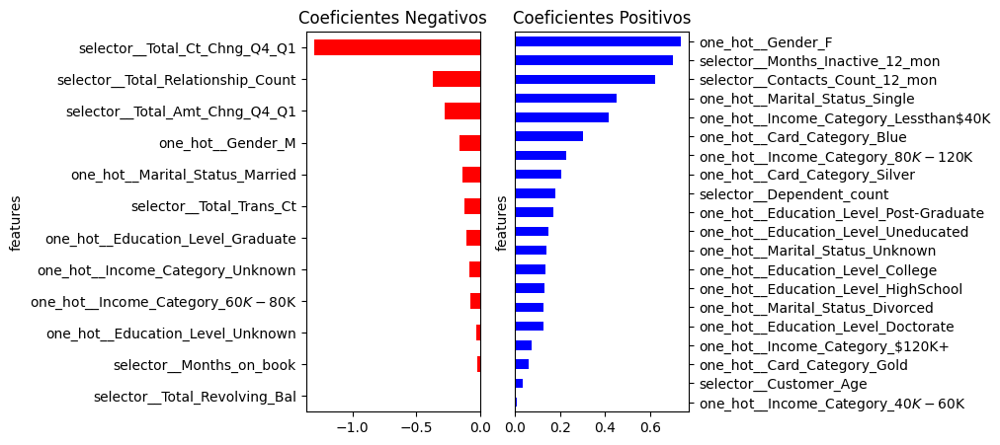

In [195]:
# plotando maiores coeficientes
plot_coefs(
  coefs = pd.DataFrame({
    'features':features,
    'coef':models['Logistica sem penalização'].coef_[0]
  }),
  n = 20
)

Curva ROC  Logistica sem penalização


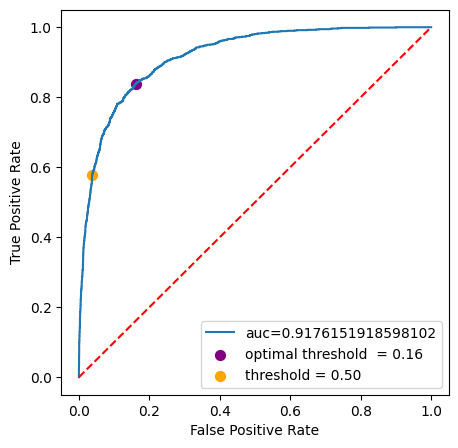

Comparação de modelos


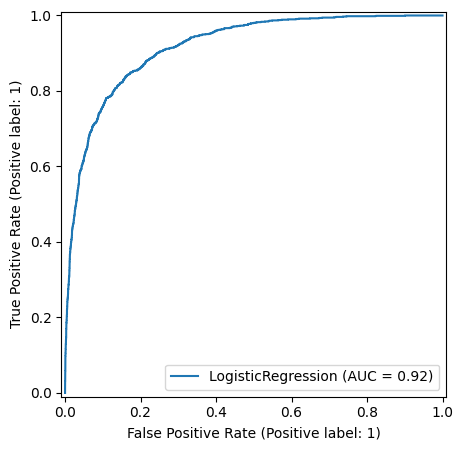

In [196]:
# ROC curve
plot_roc_curve(models, X_test, y_test)

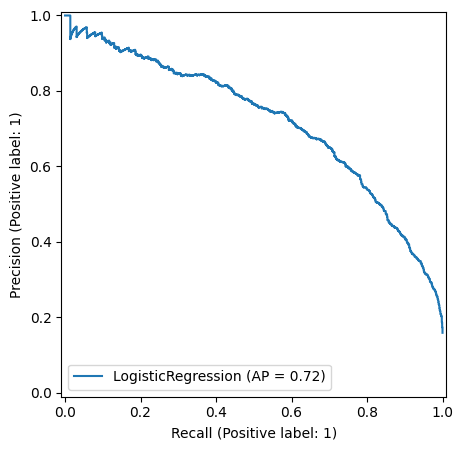

In [197]:
PrecisionRecallDisplay.from_estimator(models['Logistica sem penalização'], X_test, y_test)

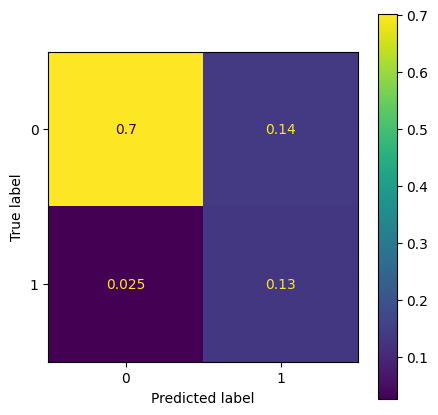

,Method,Acurácia,Precisão,Recall,F1,Log-loss
0,Logistica sem penalização,0.835,0.49,0.842,0.62,0.247


In [198]:
resultado_modelo = get_model_metrics(
  model_name='Logistica sem penalização',
  threshold=.16,
  y_prob=models['Logistica sem penalização'].predict_proba(X_test)[:,1],
  y_test=y_test)

resultados = pd.concat([resultados, resultado_modelo])
resultados

### Regressão Logística (com penalização)

In [199]:
models['Logistica penalização L1'] = linear_model.LogisticRegressionCV(
  penalty="l1",solver='liblinear',scoring='neg_log_loss',
  max_iter=100, cv=10
).fit(X=X_train,y=y_train)

In [200]:
print(f"total de variaveis com coeficientes 0 = {sum(models['Logistica penalização L1'].coef_[0]==0)}")
print(f"total de variaveis = {len(models['Logistica penalização L1'].coef_[0])}")

total de variaveis com coeficientes 0 = 12
total de variaveis = 35


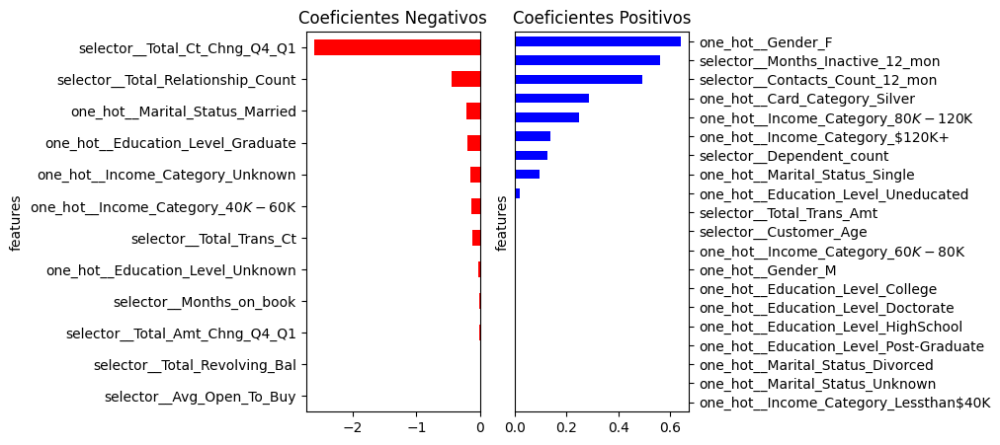

In [201]:
# plotando maiores coeficientes
logistica_l1 = models['Logistica penalização L1']
plot_coefs(
  coefs = pd.DataFrame({
    'features':features,
    'coef':logistica_l1.coef_[0]
  }),
  n = 20
)

Curva ROC  Logistica penalização L1


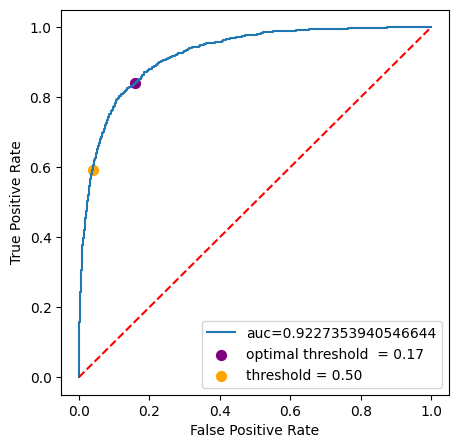

Comparação de modelos


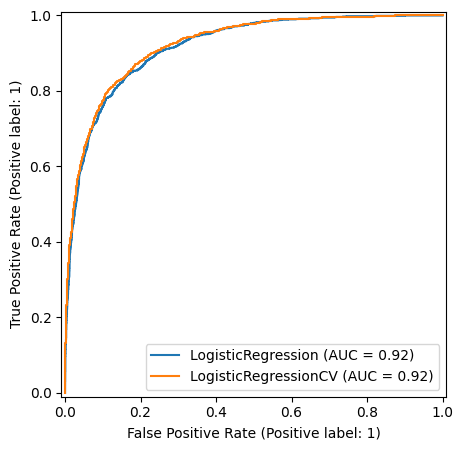

In [202]:
# ROC curve
plot_roc_curve(models, X_test, y_test)

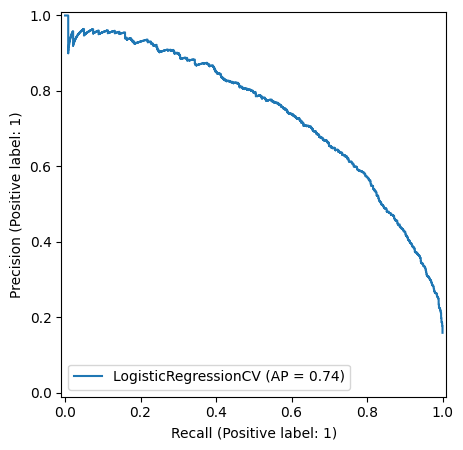

In [203]:
PrecisionRecallDisplay.from_estimator(logistica_l1, X_test, y_test)

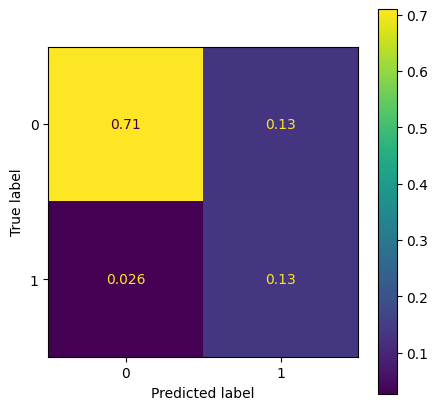

,Method,Acurácia,Precisão,Recall,F1,Log-loss
0,Logistica sem penalização,0.835,0.490,0.842,0.62,0.247
0,Logistica penalização L1,0.843,0.505,0.837,0.63,0.239


In [204]:
resultado_modelo = get_model_metrics(
  model_name='Logistica penalização L1',
  threshold=.17,
  y_prob=models['Logistica penalização L1'].predict_proba(X_test)[:,1],
  y_test=y_test)
resultados = pd.concat([resultados, resultado_modelo])
resultados

### Árvore de Decisão

Melhores Parametros: {'max_depth': 4}


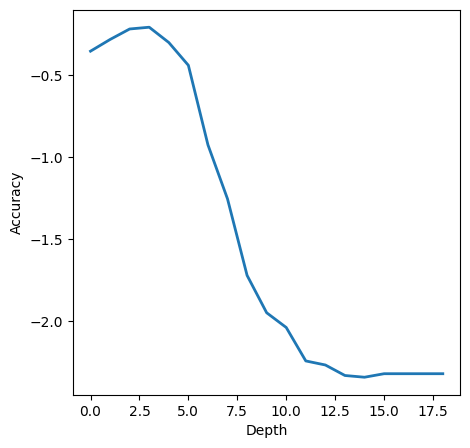

DecisionTreeClassifier(max_depth=4, random_state=0)

In [205]:
models['Arvore'] = DecisionTreeClassifier(random_state = 0)

# otimização de hiperparametros
param_grid = {'max_depth':np.arange(1, 20)}
arvore_gscv = GridSearchCV(models['Arvore'], param_grid, cv=10, scoring='neg_log_loss')
arvore_gscv.fit(X_train, y_train)

# resultado
print(f"Melhores Parametros: {arvore_gscv.best_params_}")

plt.figure()
plt.plot(arvore_gscv.cv_results_['mean_test_score'],linewidth=2)
plt.xlabel('Depth')
plt.ylabel('Accuracy')
plt.show()

# utilizando o melhores parametros
models['Arvore'].set_params(**arvore_gscv.best_params_)
models['Arvore'].fit(X_train,y_train)

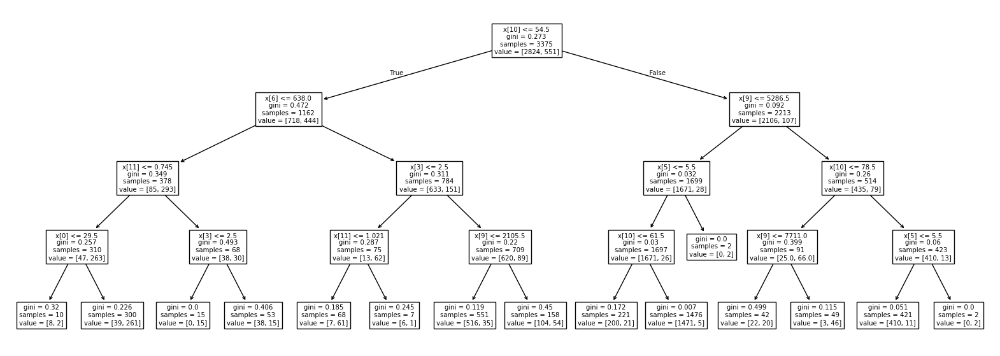

In [206]:
# plotando arvore de decisão
plt.rcParams['figure.figsize'] = [20, 7]
plot_tree(models['Arvore'])
plt.show()

In [207]:
plt.rcParams['figure.figsize'] = [5, 5]

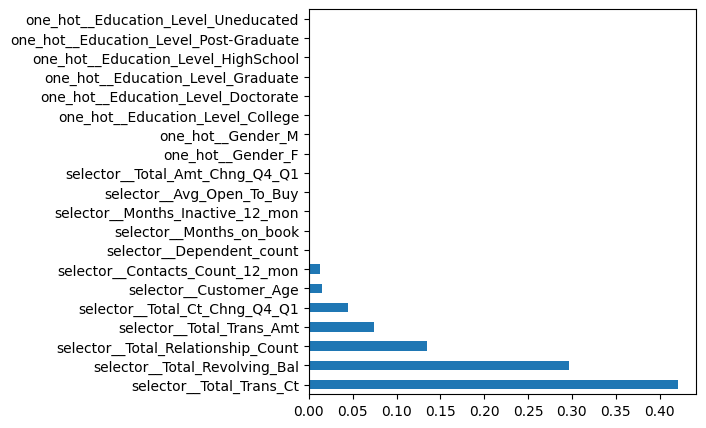

In [208]:
# plotando as variaveis mais importantes
feat_importances = pd.Series(
  models['Arvore'].feature_importances_,
  index= features)
feat_importances.nlargest(20).plot(kind='barh')
plt.show()

Curva ROC  Arvore


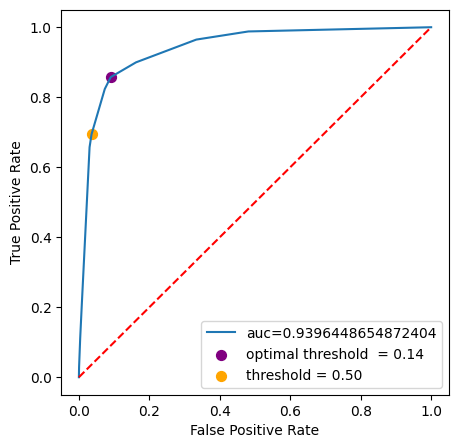

Comparação de modelos


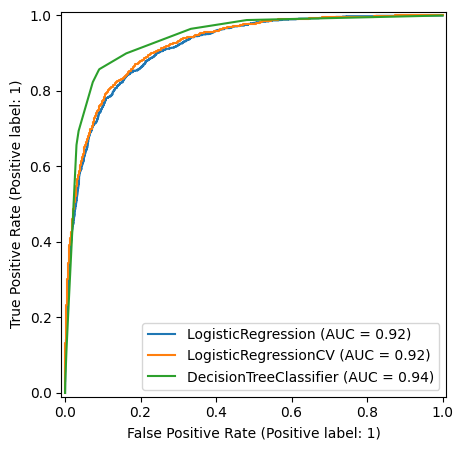

In [209]:
# ROC curve
plot_roc_curve(models, X_test, y_test)

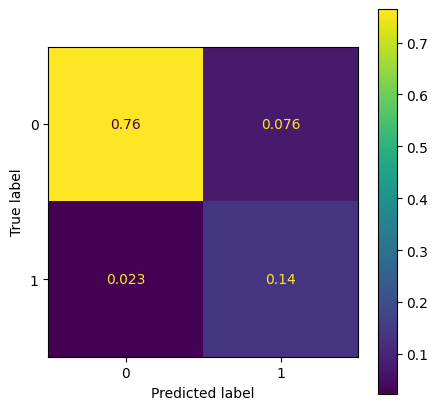

,Method,Acurácia,Precisão,Recall,F1,Log-loss
0,Logistica sem penalização,0.835,0.490,0.842,0.620,0.247
0,Logistica penalização L1,0.843,0.505,0.837,0.630,0.239
0,Arvore,0.901,0.641,0.858,0.734,0.226


In [210]:
resultado_modelo = get_model_metrics(
  model_name='Arvore',
  threshold=.14,
  y_prob=models['Arvore'].predict_proba(X_test)[:,1],
  y_test=y_test)
resultados = pd.concat([resultados, resultado_modelo])
resultados

### Florestas

Melhores Parametros: {'max_depth': 30, 'max_features': 'sqrt'}


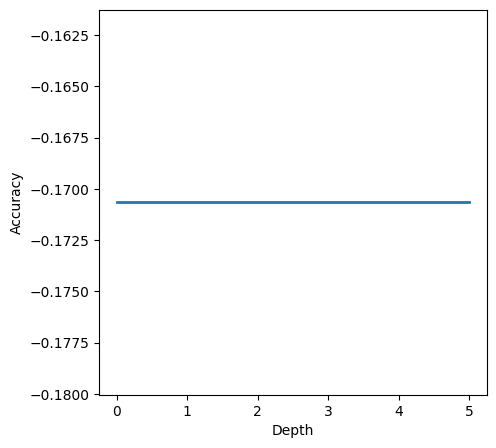

RandomForestClassifier(max_depth=30, n_estimators=400, random_state=0)

In [211]:
models['Florestas'] = RandomForestClassifier(random_state = 0, n_estimators = 400)

# otimização de hiperparametros
param_grid = {
  'max_depth': [30, 60, 90],
  'max_features': ['sqrt', 'log2']
}
floresta_gscv = GridSearchCV(models['Florestas'], param_grid, cv=2,scoring='neg_log_loss')
floresta_gscv.fit(X_train, y_train)

# resultado
print(f"Melhores Parametros: {floresta_gscv.best_params_}")

plt.figure()
plt.plot(floresta_gscv.cv_results_['mean_test_score'],linewidth=2)
plt.xlabel('Depth')
plt.ylabel('Accuracy')
plt.show()

# utilizando o melhores parametros
models['Florestas'].set_params(**floresta_gscv.best_params_)
models['Florestas'].fit(X_train,y_train)

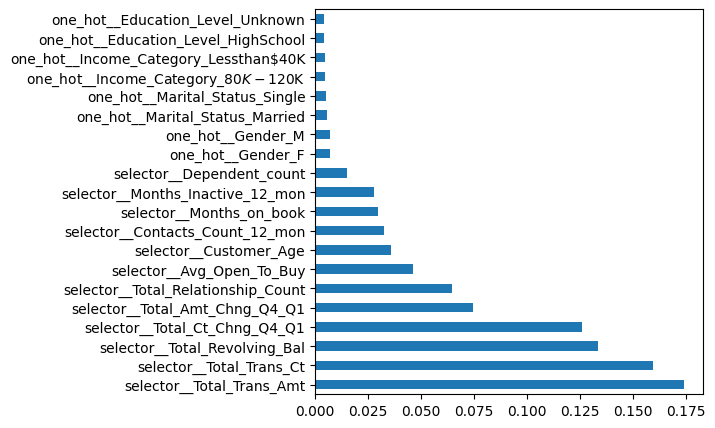

In [212]:
# plotando as variaveis mais importantes
feat_importances = pd.Series(
  models['Florestas'].feature_importances_,
  index= features)
feat_importances.nlargest(20).plot(kind='barh')
plt.show()

Curva ROC  Florestas


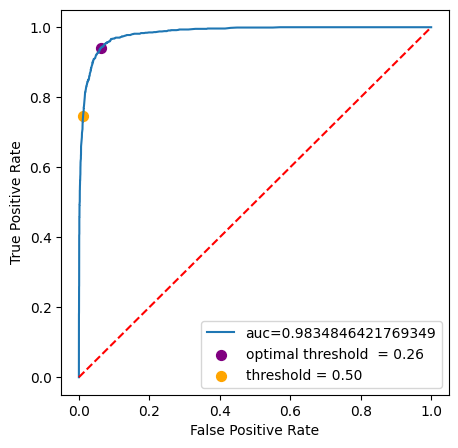

Comparação de modelos


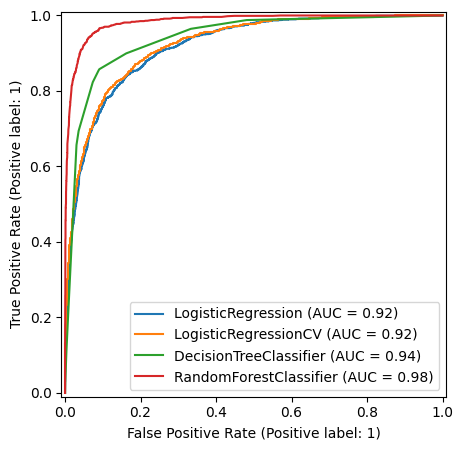

In [213]:
# ROC curve
plot_roc_curve(models, X_test, y_test)

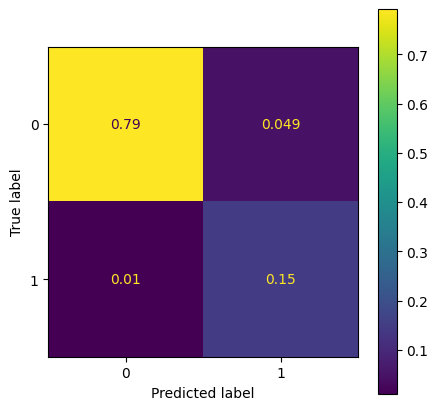

,Method,Acurácia,Precisão,Recall,F1,Log-loss
0,Logistica sem penalização,0.835,0.490,0.842,0.620,0.247
0,Logistica penalização L1,0.843,0.505,0.837,0.630,0.239
0,Arvore,0.901,0.641,0.858,0.734,0.226
0,Florestas,0.940,0.751,0.935,0.833,0.152


In [214]:
resultado_modelo = get_model_metrics(
  model_name='Florestas',
  threshold=.26,
  y_prob=models['Florestas'].predict_proba(X_test)[:,1],
  y_test=y_test)
resultados = pd.concat([resultados, resultado_modelo])
resultados

### XGBoost

In [215]:
classes_weights = list(class_weight.compute_class_weight(
  class_weight ='balanced', classes=np.unique(y_train), y=y_train
))

weights = [classes_weights[i] for i in y_train]
np.unique(weights)

array([0.59755666, 3.06261343])

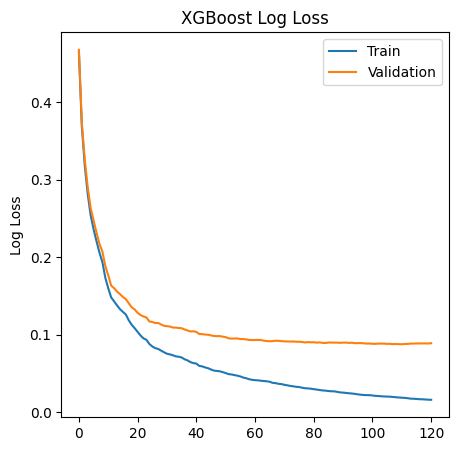

In [216]:
models['XGBoost'] = xgb.XGBClassifier(eval_metric=["logloss"], early_stopping_rounds=10,)

# otimização de hiperparametro
parameters = {'max_depth': [3,7,15,30],
              'min_child_weight': [2,5],
              'subsample': [0.8,1],
              'colsample_bytree': [0.75,1],
              'n_estimators': [350, 500],
              'eta':[0.5,1]}

X_train_1, X_val, y_train_1, y_val, _ = getTestTrainData(size=PROPORCAO_TREINO_TESTE, random_state=7)
xgb_classes_weights = list(class_weight.compute_class_weight(
  class_weight ='balanced', classes=np.unique(y_train_1), y=y_train_1
))
xgb_weights = [xgb_classes_weights[i] for i in y_train_1]
eval_set = [(X_train_1,y_train_1),(X_val, y_val)]

xgb_model_gscv = GridSearchCV(models['XGBoost'], parameters, n_jobs=4, cv=2,scoring='neg_log_loss')

xgb_model_gscv.fit(
  X_train_1, y_train_1,
  eval_set=eval_set,
  sample_weight=xgb_weights,
  verbose=0)

results = xgb_model_gscv.best_estimator_.evals_result()

models['XGBoost'].set_params(**xgb_model_gscv.best_params_)

models['XGBoost'].fit(
  X_train_1, y_train_1,
  eval_set=eval_set, 
  sample_weight=xgb_weights,
  verbose=0
)

epochs = len(results['validation_0']['logloss'])
x_axis = range(0, epochs)
# plot
fig, ax = plt.subplots()
ax.plot(x_axis, results['validation_0']['logloss'], label='Train')
ax.plot(x_axis, results['validation_1']['logloss'], label='Validation')
ax.legend()
plt.ylabel('Log Loss')
plt.title('XGBoost Log Loss')
plt.show()

Curva ROC  XGBoost


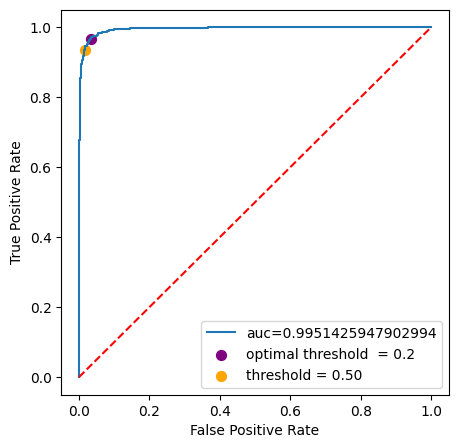

Comparação de modelos


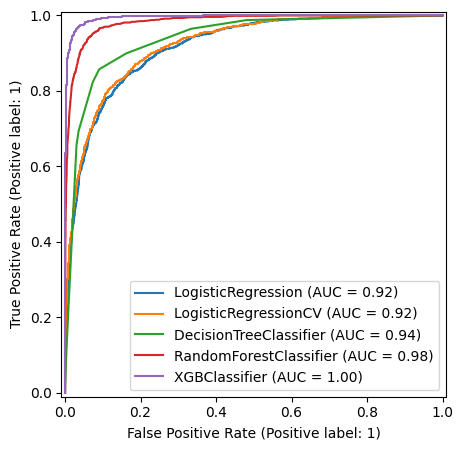

In [217]:
# ROC curve
plot_roc_curve(models, X_test, y_test)

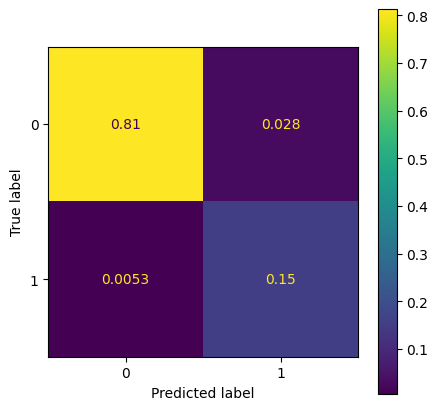

,Method,Acurácia,Precisão,Recall,F1,Log-loss
0,Logistica sem penalização,0.835,0.490,0.842,0.620,0.247
0,Logistica penalização L1,0.843,0.505,0.837,0.630,0.239
0,Arvore,0.901,0.641,0.858,0.734,0.226
0,Florestas,0.940,0.751,0.935,0.833,0.152
0,XGBoost,0.967,0.847,0.967,0.903,0.066


In [218]:
resultado_modelo = get_model_metrics(
  model_name='XGBoost',
  threshold=.2,
  y_prob=models['XGBoost'].predict_proba(X_test)[:,1],
  y_test=y_test)
resultados = pd.concat([resultados, resultado_modelo])
resultados

### LightGBM

In [219]:
models['LightGBM'] = lgb.LGBMClassifier(verbose=-1)

# otimização de hiperparametros
params_grid = {'learning_rate': [0.01], 'n_estimators': [8, 24],
                'num_leaves': [6, 8, 12, 16], 'boosting_type': ['gbdt'],
                'objective': ['binary'],
                'colsample_bytree': [0.65, 0.75, 0.8],
                'subsample': [0.7, 0.75], 'reg_alpha': [1, 2, 6],
                'reg_lambda': [1, 2, 6]}

lgb_rscv = GridSearchCV(models['LightGBM'], params_grid, cv=2,scoring='neg_log_loss')
lgb_rscv.fit(X_train, y_train, sample_weight=weights)

# resultado
print(f"Melhor Pontuação: {lgb_rscv.best_score_}")
print(f"Melhores Parametros: {lgb_rscv.best_params_}")

# utilizando o melhores parametros
models['LightGBM'].set_params(**lgb_rscv.best_params_)
models['LightGBM'].fit(X_train.astype('float32'), y_train, sample_weight=weights)

Melhor Pontuação: -0.5676568825495749
Melhores Parametros: {'boosting_type': 'gbdt', 'colsample_bytree': 0.8, 'learning_rate': 0.01, 'n_estimators': 24, 'num_leaves': 16, 'objective': 'binary', 'reg_alpha': 1, 'reg_lambda': 1, 'subsample': 0.7}


LGBMClassifier(colsample_bytree=0.8, learning_rate=0.01, n_estimators=24,
               num_leaves=16, objective='binary', reg_alpha=1, reg_lambda=1,
               subsample=0.7, verbose=-1)

Curva ROC  LightGBM


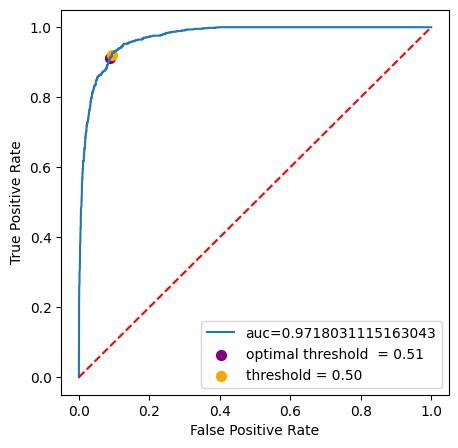

Comparação de modelos


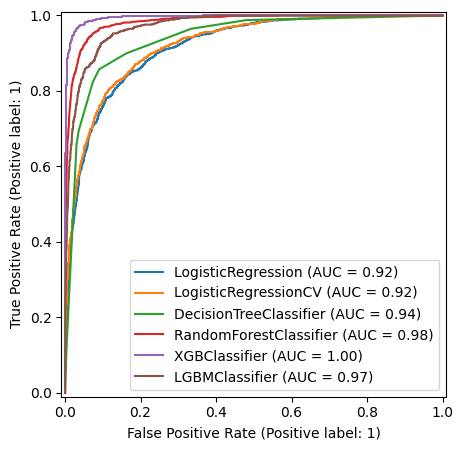

In [220]:
# ROC curve
plot_roc_curve(models, X_test, y_test)

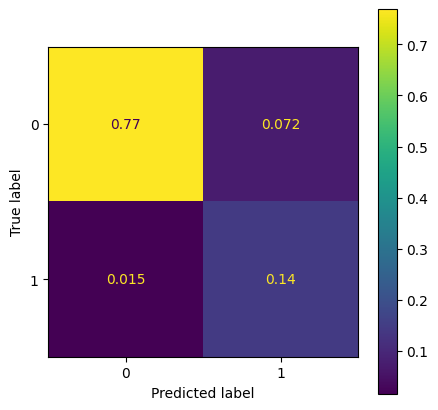

,Method,Acurácia,Precisão,Recall,F1,Log-loss
0,Logistica sem penalização,0.835,0.490,0.842,0.620,0.247
0,Logistica penalização L1,0.843,0.505,0.837,0.630,0.239
0,Arvore,0.901,0.641,0.858,0.734,0.226
0,Florestas,0.940,0.751,0.935,0.833,0.152
0,XGBoost,0.967,0.847,0.967,0.903,0.066
0,LightGBM,0.913,0.667,0.903,0.767,0.570


In [221]:
resultado_modelo = get_model_metrics(
  model_name='LightGBM',
  threshold=.51,
  y_prob=models['LightGBM'].predict_proba(X_test)[:,1],
  y_test=y_test)
resultados = pd.concat([resultados, resultado_modelo])
resultados

### CatBoost

In [222]:
models['CatBoost'] = CatBoostClassifier()

# otimização de hiperparametros
params_grid = [{
  'depth':[3,1,2,6,4,5,7,8,9,10],
  'iterations':[250,100,500,1000],
  'learning_rate':[0.03,0.001,0.01,0.1,0.2,0.3],
  'l2_leaf_reg':[3,1,5,10,100],
  'border_count':[32,5,10,20,50,100,200],
  #'ctr_border_count':[50,5,10,20,100,200],
  'thread_count':[4]
}]

catb_rscv = RandomizedSearchCV(models['CatBoost'], params_grid, cv=2, scoring='accuracy', n_iter = 15)
catb_rscv.fit(X_train, y_train, sample_weight=weights, verbose=0)

# utilizando o melhores parametros
models['CatBoost'].set_params(**catb_rscv.best_params_)
models['CatBoost'].fit(X_train, y_train, sample_weight=weights, verbose=0)

In [223]:
# resultado
print(f"Melhor Pontuação: {catb_rscv.best_params_}")
print(f"Melhores Parametros: {catb_rscv.best_params_}")

Melhor Pontuação: {'thread_count': 4, 'learning_rate': 0.3, 'l2_leaf_reg': 100, 'iterations': 250, 'depth': 7, 'border_count': 100}
Melhores Parametros: {'thread_count': 4, 'learning_rate': 0.3, 'l2_leaf_reg': 100, 'iterations': 250, 'depth': 7, 'border_count': 100}


Curva ROC  CatBoost


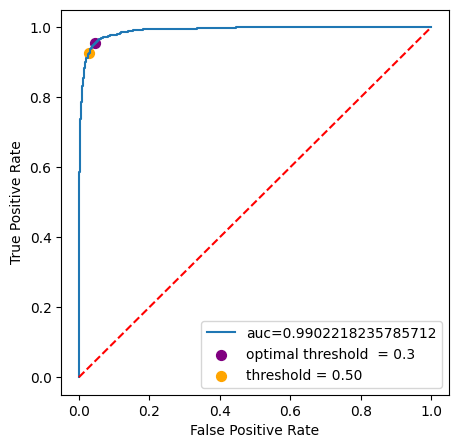

Comparação de modelos


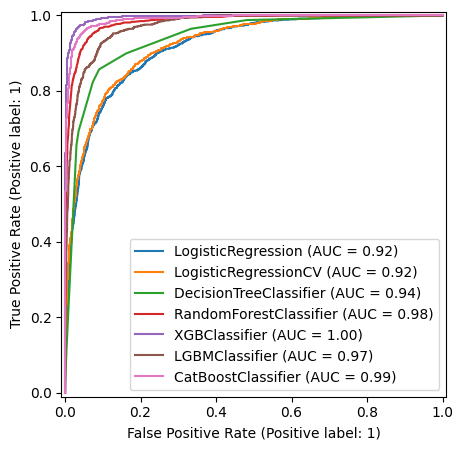

In [224]:
# ROC curve
plot_roc_curve(models, X_test, y_test)

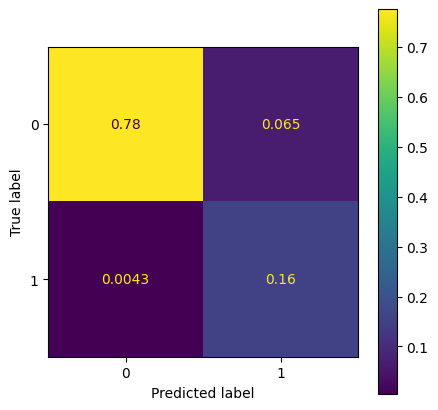

,Method,Acurácia,Precisão,Recall,F1,Log-loss
0,Logistica sem penalização,0.835,0.490,0.842,0.620,0.247
0,Logistica penalização L1,0.843,0.505,0.837,0.630,0.239
0,Arvore,0.901,0.641,0.858,0.734,0.226
0,Florestas,0.940,0.751,0.935,0.833,0.152
0,XGBoost,0.967,0.847,0.967,0.903,0.066
0,LightGBM,0.913,0.667,0.903,0.767,0.570
0,CatBoost,0.931,0.705,0.973,0.817,0.094


In [225]:
resultado_modelo = get_model_metrics(
  model_name='CatBoost',
  threshold=.14,
  y_prob=models['CatBoost'].predict_proba(X_test)[:,1],
  y_test=y_test)
resultados = pd.concat([resultados, resultado_modelo])
resultados

### KNN (com todas as variáveis)

In [226]:
from imblearn.over_sampling import RandomOverSampler
ros = RandomOverSampler(random_state=0)
X_train_resampled, y_train_resampled = ros.fit_resample(X_train, y_train)

Melhores Parametros: {'n_neighbors': 25}


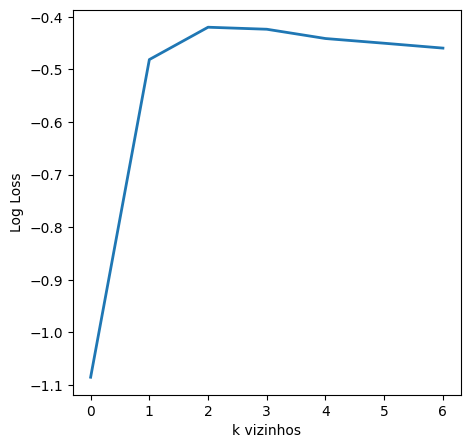

KNeighborsClassifier(n_neighbors=25)

In [227]:
# criando modelo
models['KNN'] = KNeighborsClassifier()

# otimização de hiperparametros
param_grid = {'n_neighbors': [5, 15, 25, 45, 65, 85, 100]}
knn_gscv = GridSearchCV(models['KNN'], param_grid, cv=2,scoring='neg_log_loss')
knn_gscv.fit(X_train_resampled, y_train_resampled)

# resultado
# resultado
print(f"Melhores Parametros: {knn_gscv.best_params_}")

plt.figure()
plt.plot(knn_gscv.cv_results_['mean_test_score'],linewidth=2)
plt.xlabel('k vizinhos')
plt.ylabel('Log Loss')
plt.show()

# utilizando o melhores parametros
models['KNN'].set_params(**knn_gscv.best_params_)
models['KNN'].fit(X_train,y_train)

Curva ROC  KNN


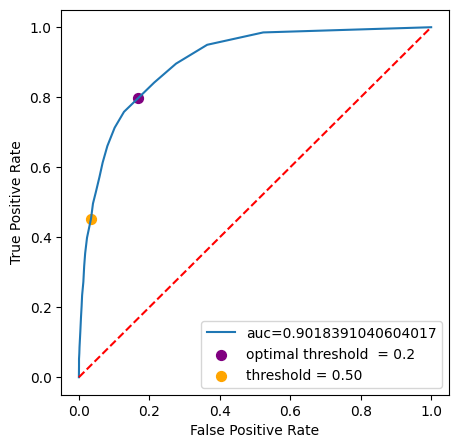

Comparação de modelos


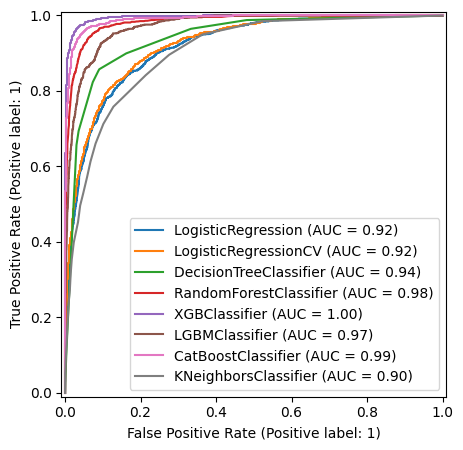

In [228]:
# ROC curve
plot_roc_curve(models, X_test, y_test)

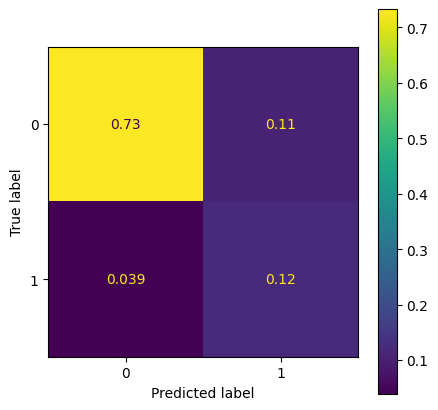

,Method,Acurácia,Precisão,Recall,F1,Log-loss
0,Logistica sem penalização,0.835,0.490,0.842,0.620,0.247
0,Logistica penalização L1,0.843,0.505,0.837,0.630,0.239
0,Arvore,0.901,0.641,0.858,0.734,0.226
0,Florestas,0.940,0.751,0.935,0.833,0.152
0,XGBoost,0.967,0.847,0.967,0.903,0.066
0,LightGBM,0.913,0.667,0.903,0.767,0.570
0,CatBoost,0.931,0.705,0.973,0.817,0.094
0,KNN,0.854,0.529,0.758,0.623,0.348


In [229]:
resultado_modelo = get_model_metrics(
  model_name='KNN',
  threshold=.2,
  y_prob=models['KNN'].predict_proba(X_test)[:,1],
  y_test=y_test)
resultados = pd.concat([resultados, resultado_modelo])
resultados

### KNN com seleção de variáveis (RFECV)

In [230]:
## Seleção de parâmetros:
from sklearn.feature_selection import RFECV
floresta_rfe = RFECV(
  models['Florestas'], min_features_to_select = 10,
  step = 0.3, verbose = 10, cv=10
).fit(X_train,y_train)

Fitting estimator with 35 features.
Fitting estimator with 25 features.
Fitting estimator with 15 features.
Fitting estimator with 35 features.
Fitting estimator with 25 features.
Fitting estimator with 15 features.
Fitting estimator with 35 features.
Fitting estimator with 25 features.
Fitting estimator with 15 features.
Fitting estimator with 35 features.
Fitting estimator with 25 features.
Fitting estimator with 15 features.
Fitting estimator with 35 features.
Fitting estimator with 25 features.
Fitting estimator with 15 features.
Fitting estimator with 35 features.
Fitting estimator with 25 features.
Fitting estimator with 15 features.
Fitting estimator with 35 features.
Fitting estimator with 25 features.
Fitting estimator with 15 features.
Fitting estimator with 35 features.
Fitting estimator with 25 features.
Fitting estimator with 15 features.
Fitting estimator with 35 features.
Fitting estimator with 25 features.
Fitting estimator with 15 features.
Fitting estimator with 35 fe

In [231]:
from imblearn.over_sampling import RandomOverSampler
ros = RandomOverSampler(random_state=0)
X_train_resampled, y_train_resampled = ros.fit_resample(X_train[features[floresta_rfe.support_]], y_train)

Melhores Parametros: {'n_neighbors': 25}


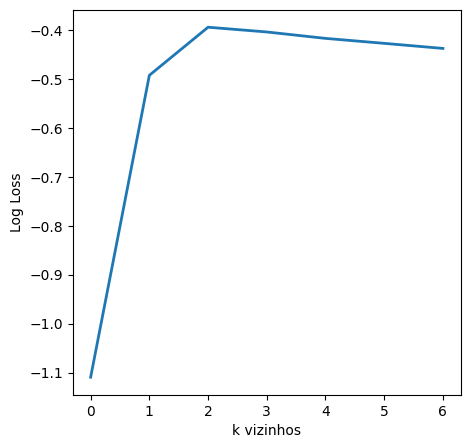

KNeighborsClassifier(n_neighbors=25)

In [232]:
# criando modelo
knn_rfe = KNeighborsClassifier()
models['KNN_RFE'] = knn_rfe

# otimização de hiperparametros
param_grid = {'n_neighbors': [5, 15, 25, 45, 65, 85, 100]}
knn_gscv = GridSearchCV(knn_rfe, param_grid, cv=5,scoring='neg_log_loss')
knn_gscv.fit(X_train_resampled, y_train_resampled)

# resultado
print(f"Melhores Parametros: {knn_gscv.best_params_}")

plt.figure()
plt.plot(knn_gscv.cv_results_['mean_test_score'],linewidth=2)
plt.xlabel('k vizinhos')
plt.ylabel('Log Loss')
plt.show()

# utilizando o melhores parametros
knn_rfe.set_params(**knn_gscv.best_params_)
knn_rfe.fit(X_train[features[floresta_rfe.support_]],y_train)

Curva ROC  KNN_RFE


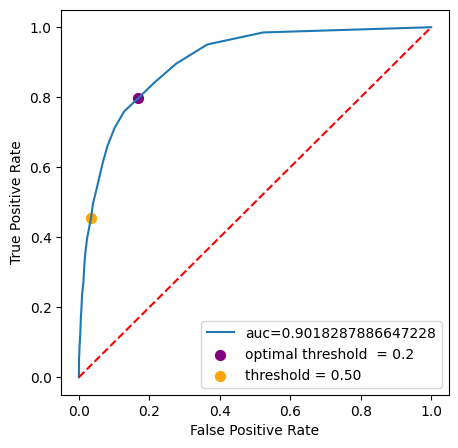

Comparação de modelos


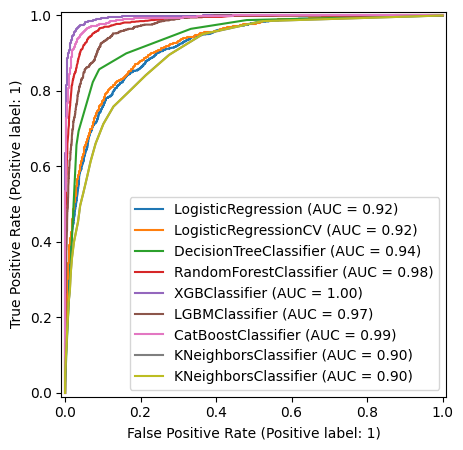

In [233]:
# ROC curve
plot_roc_curve(models, X_test, y_test)

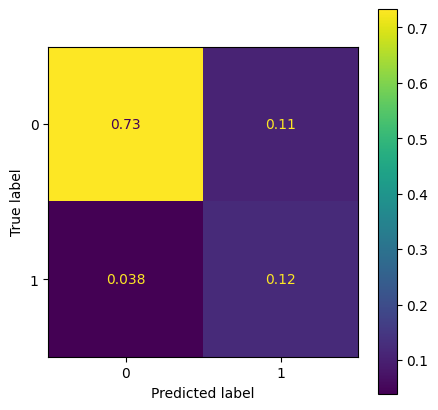

,Method,Acurácia,Precisão,Recall,F1,Log-loss
0,Logistica sem penalização,0.835,0.490,0.842,0.620,0.247
0,Logistica penalização L1,0.843,0.505,0.837,0.630,0.239
0,Arvore,0.901,0.641,0.858,0.734,0.226
0,Florestas,0.940,0.751,0.935,0.833,0.152
0,XGBoost,0.967,0.847,0.967,0.903,0.066
0,LightGBM,0.913,0.667,0.903,0.767,0.570
0,CatBoost,0.931,0.705,0.973,0.817,0.094
0,KNN,0.854,0.529,0.758,0.623,0.348
0,KNN RFE,0.854,0.528,0.759,0.623,0.348


In [234]:
resultado_modelo = get_model_metrics(
  model_name='KNN RFE',
  threshold=.2,
  y_prob=knn_rfe.predict_proba(X_test[features[floresta_rfe.support_]])[:,1],
  y_test=y_test)
resultados = pd.concat([resultados, resultado_modelo])
resultados

### Naive Bayes

In [235]:
X_train_df = pd.DataFrame(X_train, columns=features)
X_test_df  = pd.DataFrame(X_test, columns=features)

models['NB'] = GaussianNB().fit(X_train, y_train)

Curva ROC  NB


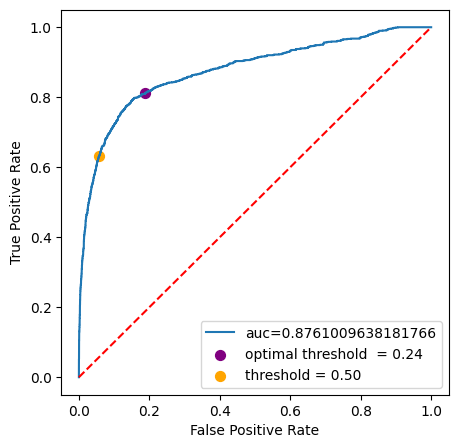

Comparação de modelos


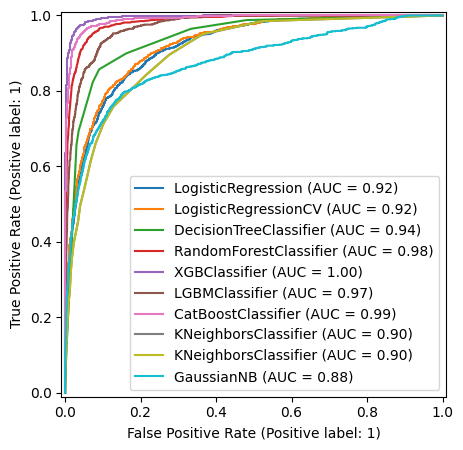

In [236]:
# ROC curve
plot_roc_curve(models, X_test, y_test)

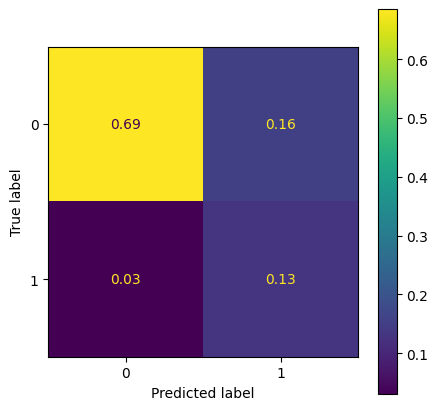

,Method,Acurácia,Precisão,Recall,F1,Log-loss
0,Logistica sem penalização,0.835,0.490,0.842,0.620,0.247
0,Logistica penalização L1,0.843,0.505,0.837,0.630,0.239
0,Arvore,0.901,0.641,0.858,0.734,0.226
0,Florestas,0.940,0.751,0.935,0.833,0.152
0,XGBoost,0.967,0.847,0.967,0.903,0.066
0,LightGBM,0.913,0.667,0.903,0.767,0.570
0,CatBoost,0.931,0.705,0.973,0.817,0.094
0,KNN,0.854,0.529,0.758,0.623,0.348
0,KNN RFE,0.854,0.528,0.759,0.623,0.348
0,Naive Bayes,0.814,0.454,0.809,0.581,0.300


In [237]:
resultado_modelo = get_model_metrics(
  model_name='Naive Bayes',
  threshold=.24,
  y_prob=models['NB'].predict_proba(X_test)[:,1],
  y_test=y_test)
resultados = pd.concat([resultados, resultado_modelo])
resultados

### Nnets

Model: "sequential_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ dense_5 (Dense)                 │ (None, 100)            │         3,600 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_3 (Dropout)             │ (None, 100)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_6 (Dense)                 │ (None, 100)            │        10,100 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_4 (Dropout)             │ (None, 100)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_7 (Dense)                 │ (None, 100)            │        10,100 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_5 (Dropout)             │ (None, 100)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_8 (Dense)                 │ (None, 32)             │         3,232 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_9 (Dense)                 │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 27,065 (105.72 KB)

 Trainable params: 27,065 (105.72 KB)

 Non-trainable params: 0 (0.00 B)

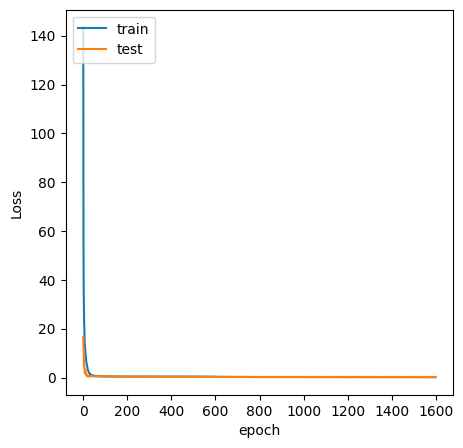

In [238]:
model = keras.Sequential([
  keras.Input(shape=X_train_df.iloc[0].shape),
  layers.Dense(100, activation="relu"),
  layers.Dropout(0.2),
  layers.Dense(100, activation="relu"),
  layers.Dropout(0.2),
  layers.Dense(100, activation="relu"),
  layers.Dropout(0.2),
  layers.Dense(32, activation="relu"),
  layers.Dense(1, activation="sigmoid"),
])

model.summary()

batch_size = 200
epochs = 1600

metrics_score = [
  keras.metrics.FalseNegatives(name="fn"),
  keras.metrics.FalsePositives(name="fp"),
  keras.metrics.TrueNegatives(name="tn"),
  keras.metrics.TruePositives(name="tp"),
  keras.metrics.Precision(name="precision"),
  keras.metrics.Recall(name="recall"),
]

model.compile(loss="binary_crossentropy", optimizer="adam", metrics=metrics_score)

history = model.fit(
  X_train, y_train,
  batch_size=batch_size, epochs=epochs,
  validation_split=0.1, shuffle=True, verbose=0)

plt.figure()
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.ylabel('Loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

211/211 ━━━━━━━━━━━━━━━━━━━━ 0s 744us/step


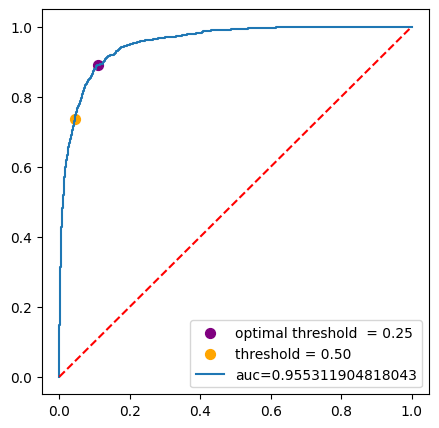

In [239]:
# plot curva ROC:
y_pred_proba = model.predict(X_test)
fpr, tpr, thresholds = metrics.roc_curve(y_test,  y_pred_proba)
auc = metrics.roc_auc_score(y_test, y_pred_proba)
roc = pd.DataFrame({
  'fpr' : fpr,
  'tpr' : tpr,
  'tf' : tpr - (1-fpr),
  'thresholds' : thresholds
})
# optimal threshold
optimalThreshold(roc)
# .5 threshold
dotFiveThreshold(roc)

plt.plot(fpr,tpr,label="auc="+str(auc))
plt.legend(loc=4)
plt.plot( [0,1], [0,1], '--r')
plt.show()

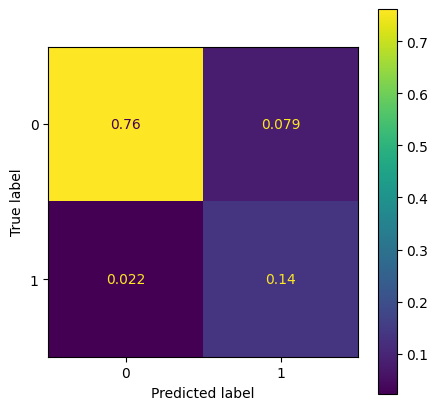

,Method,Acurácia,Precisão,Recall,F1,Log-loss
0,Logistica sem penalização,0.835,0.490,0.842,0.620,0.247
0,Logistica penalização L1,0.843,0.505,0.837,0.630,0.239
0,Arvore,0.901,0.641,0.858,0.734,0.226
0,Florestas,0.940,0.751,0.935,0.833,0.152
0,XGBoost,0.967,0.847,0.967,0.903,0.066
0,LightGBM,0.913,0.667,0.903,0.767,0.570
0,CatBoost,0.931,0.705,0.973,0.817,0.094
0,KNN,0.854,0.529,0.758,0.623,0.348
0,KNN RFE,0.854,0.528,0.759,0.623,0.348
0,Naive Bayes,0.814,0.454,0.809,0.581,0.300


In [240]:
# plot confunsion matriz
resultado_modelo = get_model_metrics(
  model_name='NNnets',
  threshold=.3,
  y_prob=y_pred_proba,
  y_test=y_test)
resultados = pd.concat([resultados, resultado_modelo])
resultados

### Voting Classifier

In [241]:
### Melhores resultados:
resultados.sort_values('Log-loss')

,Method,Acurácia,Precisão,Recall,F1,Log-loss
0,XGBoost,0.967,0.847,0.967,0.903,0.066
0,CatBoost,0.931,0.705,0.973,0.817,0.094
0,Florestas,0.940,0.751,0.935,0.833,0.152
0,NNnets,0.899,0.636,0.862,0.732,0.194
0,Arvore,0.901,0.641,0.858,0.734,0.226
0,Logistica penalização L1,0.843,0.505,0.837,0.630,0.239
0,Logistica sem penalização,0.835,0.490,0.842,0.620,0.247
0,Naive Bayes,0.814,0.454,0.809,0.581,0.300
0,KNN,0.854,0.529,0.758,0.623,0.348
0,KNN RFE,0.854,0.528,0.759,0.623,0.348


In [242]:
voting_models = ['Florestas', 'Logistica penalização L1', 'KNN_RFE', 'CatBoost', 'XGBoost']

set_config(enable_metadata_routing=True)
models['Florestas'].set_fit_request(sample_weight=False)
models['Logistica penalização L1'].set_fit_request(sample_weight=True)
models['XGBoost'].set_fit_request(eval_set=True, sample_weight=True)

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None, colsample_bytree=1,
              device=None, early_stopping_rounds=10, enable_categorical=False,
              eta=0.5, eval_metric=['logloss'], feature_types=None, gamma=None,
              grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=None, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=3, max_leaves=None,
              min_child_weight=2, missing=nan, monotone_constraints=None,
              multi_strategy=None, n_estimators=350, n_jobs=None,
              num_parallel_tree=None, ...)

In [243]:
estimators = [
  (model_name, models[model_name])
    for model_name in voting_models
]

fit_params = {
  'eval_set': eval_set,
  'sample_weight': xgb_weights
}
models['VotingClassifier'] = ensemble.VotingClassifier(
  estimators=estimators, 
  voting='soft', 
  n_jobs=-1
)

models['VotingClassifier'].fit(X_train, y_train, **fit_params)

VotingClassifier(estimators=[('Florestas',
                              RandomForestClassifier(max_depth=30,
                                                     n_estimators=400,
                                                     random_state=0)),
                             ('Logistica penalização L1',
                              LogisticRegressionCV(cv=10, penalty='l1',
                                                   scoring='neg_log_loss',
                                                   solver='liblinear')),
                             ('KNN_RFE', KNeighborsClassifier(n_neighbors=25)),
                             ('CatBoost',
                              <catboost.core.CatBoostClassifier object at 0x00000221683471C0>),
                             ('XGB...
                                            grow_policy=None,
                                            importance_type=None,
                                            interaction_constraints=None,
                                            learning_rate=None, max_bin=None,
                                            max_cat_threshold=None,
                                            max_cat_to_onehot=None,
                                            max_delta_step=None, max_depth=3,
                                            max_leaves=None, min_child_weight=2,
                                            missing=nan,
                                            monotone_constraints=None,
                                            multi_strategy=None,
                                            n_estimators=350, n_jobs=None,
                                            num_parallel_tree=None, ...))],
                 n_jobs=-1, voting='soft')

Curva ROC  VotingClassifier


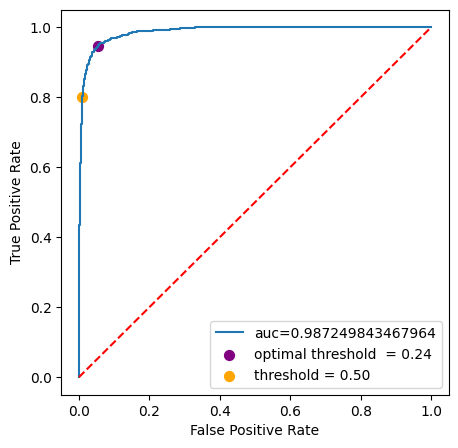

Comparação de modelos


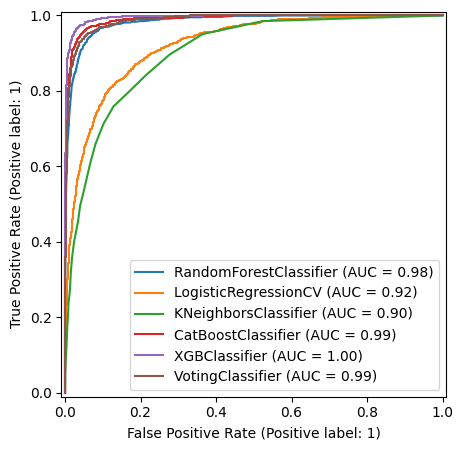

In [244]:
# ROC curve
plot_roc_curve({
  model_name: models[model_name]
  for model_name in voting_models + ['VotingClassifier']
}, X_test_df, y_test)

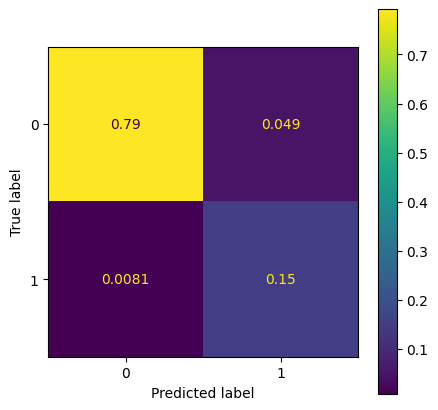

,Method,Acurácia,Precisão,Recall,F1,Log-loss
0,Logistica sem penalização,0.835,0.490,0.842,0.620,0.247
0,Logistica penalização L1,0.843,0.505,0.837,0.630,0.239
0,Arvore,0.901,0.641,0.858,0.734,0.226
0,Florestas,0.940,0.751,0.935,0.833,0.152
0,XGBoost,0.967,0.847,0.967,0.903,0.066
0,LightGBM,0.913,0.667,0.903,0.767,0.570
0,CatBoost,0.931,0.705,0.973,0.817,0.094
0,KNN,0.854,0.529,0.758,0.623,0.348
0,KNN RFE,0.854,0.528,0.759,0.623,0.348
0,Naive Bayes,0.814,0.454,0.809,0.581,0.300


In [245]:
resultado_modelo = get_model_metrics(
  model_name='VotingClassifier',
  threshold=.23,
  y_prob=models['VotingClassifier'].predict_proba(X_test_df)[:,1],
  y_test=y_test)
resultados = pd.concat([resultados, resultado_modelo])
resultados

### Stacking Classifier

In [246]:
stacking_models = ['Florestas', 'Logistica penalização L1', 'KNN_RFE', 'CatBoost', 'LightGBM']

set_config(enable_metadata_routing=False)

class MyXGBoostWithParams(xgb.sklearn.XGBClassifier):
  eval_set = None
  sample_weight = None
  
  def setParams(self, fit_params):
    self.eval_set=fit_params['eval_set']
    self.sample_weight=fit_params['sample_weight']
  
  def fit(self, X, y):
    return super(xgb.sklearn.XGBClassifier, self).fit(X,y, eval_set=eval_set, sample_weight=sample_weight)

In [247]:
# Tentativa de Work Around - Classe não esta aceitando metadata 
fit_params = {
  'eval_set': eval_set,
  'sample_weight': xgb_weights
}
customModel = MyXGBoostWithParams(models['XGBoost'])
customModel.setParams(fit_params=fit_params)
#estimators[-1] = ('XGBoost', customModel) # Nao deu certo..

In [248]:
estimators=[
  (model_name, models[model_name])
  for model_name in stacking_models
]

models['StackingClassifier'] = ensemble.StackingClassifier(
  estimators=estimators,
  n_jobs=-1
)
models['StackingClassifier'].fit(X_train_df, y_train)

StackingClassifier(estimators=[('Florestas',
                                RandomForestClassifier(max_depth=30,
                                                       n_estimators=400,
                                                       random_state=0)),
                               ('Logistica penalização L1',
                                LogisticRegressionCV(cv=10, penalty='l1',
                                                     scoring='neg_log_loss',
                                                     solver='liblinear')),
                               ('KNN_RFE',
                                KNeighborsClassifier(n_neighbors=25)),
                               ('CatBoost',
                                <catboost.core.CatBoostClassifier object at 0x00000221683471C0>),
                               ('LightGBM',
                                LGBMClassifier(colsample_bytree=0.8,
                                               learning_rate=0.01,
                                               n_estimators=24, num_leaves=16,
                                               objective='binary', reg_alpha=1,
                                               reg_lambda=1, subsample=0.7,
                                               verbose=-1))],
                   n_jobs=-1)

Curva ROC  StackingClassifier


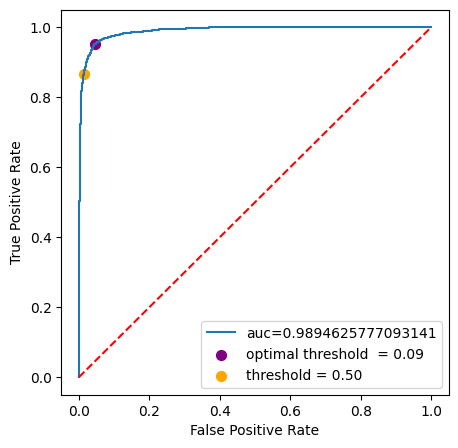

Comparação de modelos


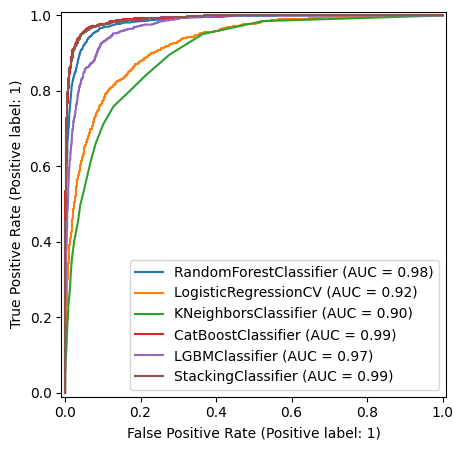

In [249]:
# ROC curve
plot_roc_curve({
  model_name: models[model_name]
  for model_name in stacking_models + ['StackingClassifier']
}, X_test_df, y_test)

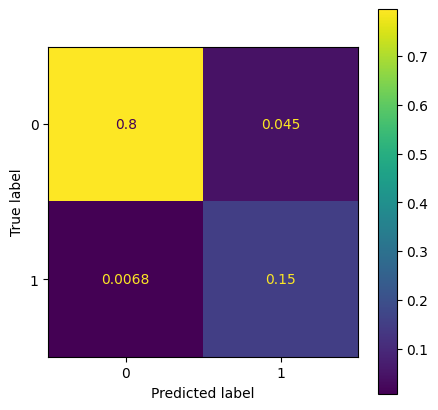

In [250]:
resultado_modelo = get_model_metrics(
  model_name='StackingClassifier',
  threshold=.07,
  y_prob=models['StackingClassifier'].predict_proba(X_test_df)[:,1],
  y_test=y_test)
resultados = pd.concat([resultados, resultado_modelo])
#resultados

# Resultado

In [251]:
resultados

,Method,Acurácia,Precisão,Recall,F1,Log-loss
0,Logistica sem penalização,0.835,0.490,0.842,0.620,0.247
0,Logistica penalização L1,0.843,0.505,0.837,0.630,0.239
0,Arvore,0.901,0.641,0.858,0.734,0.226
0,Florestas,0.940,0.751,0.935,0.833,0.152
0,XGBoost,0.967,0.847,0.967,0.903,0.066
0,LightGBM,0.913,0.667,0.903,0.767,0.570
0,CatBoost,0.931,0.705,0.973,0.817,0.094
0,KNN,0.854,0.529,0.758,0.623,0.348
0,KNN RFE,0.854,0.528,0.759,0.623,0.348
0,Naive Bayes,0.814,0.454,0.809,0.581,0.300
